In [1]:
from __future__ import print_function
# We'll need numpy for some mathematical operations
import numpy as np

# matplotlib for displaying the output
import matplotlib.pyplot as plt
import matplotlib.style as ms
ms.use('seaborn-muted')
%matplotlib notebook
# and IPython.display for audio output
import IPython.display

# Librosa for audio
import librosa
# And the display module for visualization
import librosa.display
from tqdm import tqdm

In [2]:
def to_complex(r, i):
    return np.vectorize(complex)(r, i)

In [3]:
def mag_phase_to_amp_phase(mag, phs):
    return to_complex(np.sqrt(mag**2 - phs**2), phs)

In [4]:
def griffinlim(spectrogram, n_iter = 100, window = 'hann', n_fft = 2048, hop_length = -1, verbose = False, angles=None):
    if hop_length == -1:
        hop_length = n_fft // 4
    
    if angles is None:
        angles = np.exp(2j * np.pi * np.random.rand(*spectrogram.shape))

    t = tqdm(range(n_iter), ncols=100, mininterval=2.0, disable=not verbose)
    for i in t:
        full = np.abs(spectrogram).astype(np.complex) * angles
        inverse = librosa.istft(full, hop_length = hop_length, window = window)
        rebuilt = librosa.stft(inverse, n_fft = n_fft, hop_length = hop_length, window = window)
        angles = np.exp(1j * np.angle(rebuilt))

        if verbose:
            diff = np.abs(spectrogram) - np.abs(rebuilt)
            t.set_postfix(loss=np.linalg.norm(diff, 'fro'))

    full = np.abs(spectrogram).astype(np.complex) * angles
    inverse = librosa.istft(full, hop_length = hop_length, window = window)

    return inverse

In [5]:
audio_path = 'C:\\Users\\nimro\Music\Hiatus Kaiyote\Choose Your Weapon\\17 Molasses.mp3'
# audio_path = librosa.util.example_audio_file()
y, sr = librosa.load(audio_path)

In [ ]:
# Play it back!
IPython.display.Audio(data=y, rate=sr)

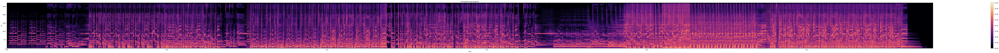

In [6]:
# Let's make and display a mel-scaled power (energy-squared) spectrogram
S = librosa.feature.melspectrogram(y, sr=sr, n_mels=512)
# Convert to log scale (dB). We'll use the peak power (max) as reference.
log_S = librosa.power_to_db(S, ref=np.max)

# Make a new figure
plt.rcParams["figure.figsize"] = (128, 6)
plt.figure(figsize=(128,6))

# Display the spectrogram on a mel scale
# sample rate and hop length parameters are used to render the time axis
librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel')

# Put a descriptive title on the plot
plt.title('mel power spectrogram')

# draw a color bar
plt.colorbar(format='%+02.0f dB')

# Make the figure layout compact
plt.tight_layout()

In [ ]:
y_harmonic, y_percussive = librosa.effects.hpss(y)

In [ ]:
y_sum = y_harmonic + y_percussive
diffs = np.abs(y_sum - y)
print(np.sum(diffs) / np.sum(np.abs(y)))

In [ ]:
# What do the spectrograms look like?
# Let's make and display a mel-scaled power (energy-squared) spectrogram
S_harmonic   = librosa.feature.melspectrogram(y_harmonic, sr=sr, n_mels=512)
S_percussive = librosa.feature.melspectrogram(y_percussive, sr=sr, n_mels=512)

# Convert to log scale (dB). We'll use the peak power as reference.
log_Sh = librosa.power_to_db(S_harmonic, ref=np.max)
log_Sp = librosa.power_to_db(S_percussive, ref=np.max)

# Make a new figure
plt.figure(figsize=(12,6))

plt.subplot(2,1,1)
# Display the spectrogram on a mel scale
librosa.display.specshow(log_Sh, sr=sr, y_axis='mel')

# Put a descriptive title on the plot
plt.title('mel power spectrogram (Harmonic)')

# draw a color bar
plt.colorbar(format='%+02.0f dB')

plt.subplot(2,1,2)
librosa.display.specshow(log_Sp, sr=sr, x_axis='time', y_axis='mel')

# Put a descriptive title on the plot
plt.title('mel power spectrogram (Percussive)')

# draw a color bar
plt.colorbar(format='%+02.0f dB')

# Make the figure layout compact
plt.tight_layout()

In [ ]:
sf = librosa.core.stft(y)
sf_harmonic = librosa.core.stft(y_harmonic)
sf_percussive = librosa.core.stft(y_percussive)
sf_sum = sf_harmonic + sf_percussive

diffs = np.abs(sf - sf_sum)
print(np.sum(diffs) / np.sum(np.abs(sf)))

In [ ]:
# Play harmonics
IPython.display.Audio(data=y_harmonic, rate=sr)

In [ ]:
# Play percussives
IPython.display.Audio(data=y_percussive, rate=sr)

(1025, 12467)


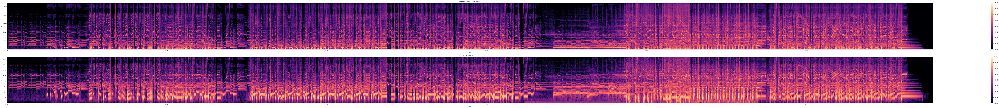

In [10]:
sf = librosa.core.stft(y)
D = np.abs(sf)
S = librosa.feature.melspectrogram(S=np.abs(sf)**2, sr=sr, n_mels=512)

# Convert to log scale (dB). We'll use the peak power (max) as reference.
log_S = librosa.power_to_db(S, ref=np.max)
log_D = librosa.amplitude_to_db(D, ref=np.max)
print(log_D.shape)
# Make a new figure
plt.rcParams["figure.figsize"] = (128, 12)
plt.figure(figsize=(128, 12))

# Display the spectrogram on a mel scale
# sample rate and hop length parameters are used to render the time axis
plt.subplot(2,1,1)
librosa.display.specshow(log_S, sr=sr, x_axis='time', y_axis='mel')

# Put a descriptive title on the plot
plt.title('log mel power spectrogram')

# draw a color bar
plt.colorbar(format='%+02.0f dB')

plt.subplot(2,1,2)
librosa.display.specshow(log_D, sr=sr, x_axis='time', y_axis='log')

# Put a descriptive title on the plot
plt.title('log magnitude spectrogram )')

# draw a color bar
plt.colorbar(format='%+02.0f dB')

# Make the figure layout compact
plt.tight_layout()


In [9]:
mag = np.abs(sf)
angles = np.exp(1j * np.angle(sf))
isf = griffinlim(mag, n_iter=10, angles=angles)
print(np.max(sf))

(433.32724-101.99733j)


In [1]:
import numpy as np
import os
import librosa
import data_processing
import IPython.display
SPECT = r"C:\\Users\nimro\Projects\VoiceSeparation\V1"
p = os.path.join(SPECT, r"spect", r"17 Molasses__log_mag.bin")
mag_db = np.memmap(p, dtype='float32', mode='r').reshape(1025, -1)
mag = librosa.db_to_amplitude(mag_db)
y = data_processing.griffinlim(mag)
IPython.display.Audio(data=y, rate=22050)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
